In [2]:
from glob import glob 
import os 
import shutil 
from tqdm import tqdm

In [3]:
train_path = "/kaggle/input/fluo-n2dl-hela/Fluo-N2DL-HeLa_train/Fluo-N2DL-HeLa"
test_path =  "/kaggle/input/fluo-n2dl-hela/Fluo-N2DL-HeLa_test/Fluo-N2DL-HeLa"
images_subfolders = ["01","02"]

train_images = []
train_masks = []
test_images = []

for subfolder in images_subfolders:
    train_img_list = glob(os.path.join(train_path,subfolder,"*"))
    train_mask_list = glob(os.path.join(train_path,subfolder+"_ERR_SEG","*"))
    test_img_list = glob(os.path.join(test_path,subfolder,"*"))
    
    train_images += train_img_list
    train_masks += train_mask_list
    test_images += test_img_list

In [4]:
root = "dataset"
for subfolder in ["images","masks"]:
    os.makedirs(os.path.join(root,subfolder),exist_ok=True)

def move(list_images,subfolder, dest=root):
    for image_path in tqdm(list_images):
        shutil.copy(image_path,os.path.join(root,subfolder)) 

move(train_images,"images")
move(train_masks,"masks")

100%|██████████| 184/184 [00:00<00:00, 359.35it/s]


In [16]:
# # nucleus_dataset.py
# from pathlib import Path
# import numpy as np, torch, skimage.io as io
# from torch.utils.data import Dataset
# from torchvision.transforms import functional as F
# import albumentations as A
# from albumentations.pytorch import ToTensorV2

# from PIL import Image
# from skimage import io



# def get_augs(train=True):
#     if not train:
#         # only convert to tensor, keep masks aligned
#         return A.Compose([ToTensorV2(transpose_mask=True)],
#                          additional_targets={'mask': 'mask'})
#     return A.Compose([
#         A.HorizontalFlip(p=0.5),
#         A.VerticalFlip(p=0.5),
#         A.RandomRotate90(p=0.5),
#         A.Rotate(limit=20, border_mode=0, p=0.5),
#         A.ElasticTransform(alpha=20, sigma=3, alpha_affine=10, p=0.3),
#         A.RandomBrightnessContrast(0.15, 0.15, p=0.4),
#         A.GaussNoise(var_limit=(5,20), p=0.3),
#         ToTensorV2(transpose_mask=True),
#     ], additional_targets={'mask': 'mask'})

# class NucleusDataset(Dataset):
#     def __init__(self, root=None, transforms=None):
#         self.imgs  = sorted((Path(root)/"images").glob("*.tif"))
#         self.masks = sorted((Path(root)/"masks").glob("*.tif"))
#         assert len(self.imgs) == len(self.masks), "img/mask count mismatch"
#         self.transforms = transforms

#     def __getitem__(self, idx):
#         # img  = io.imread(self.imgs[idx])          # H×W or H×W×C
#         # mask = io.imread(self.masks[idx])         # H×W label map
#         img  = safe_imread(self.imgs[idx])
#         mask = safe_imread(self.masks[idx])

#         if img.ndim == 2:                         # grayscale → fake RGB
#             img = np.stack([img]*3, -1)
#         img  = img.astype(np.float32)
#         img /= img.max()                          # keep 16‑bit dynamics

#         # --- Albumentations ---
#         if self.transforms:
#             aug = self.transforms(image=img, mask=mask)
#             img, mask = aug["image"], aug["mask"]

#         # --- make sure mask is a NumPy array ---
#         if torch.is_tensor(mask):
#             mask = mask.cpu().numpy()

#         # build instance targets -------------------------------------------
#         obj_ids = np.unique(mask)[1:]        # skip background 0
#         masks   = mask[None] == obj_ids[:, None, None]   # shape N×H×W

#         boxes, labels = [], []
#         for m in masks:
#             pos = np.where(m)
#             xmin, xmax = np.min(pos[1]), np.max(pos[1])
#             ymin, ymax = np.min(pos[0]), np.max(pos[0])
#             boxes.append([xmin, ymin, xmax, ymax])
#             labels.append(1)                 # single class “cell”

#         target = {
#             "boxes":  torch.as_tensor(boxes,  dtype=torch.float32),
#             "labels": torch.as_tensor(labels, dtype=torch.int64),
#             "masks":  torch.as_tensor(masks,  dtype=torch.uint8),
#             "image_id": torch.tensor([idx]),
#         }
#         return img, target

#     def __len__(self):
#         return len(self.imgs)

In [5]:
# nucleus_dataset.py
from pathlib import Path
import numpy as np, torch, skimage.io as io
from torch.utils.data import Dataset
from torchvision.transforms import functional as F
import albumentations as A
from albumentations.pytorch import ToTensorV2

def safe_imread(path):
    try:
        return io.imread(path)               # skimage + imagecodecs
    except ValueError as e:                  # no codec? try Pillow
        if "imagecodecs" in str(e):
            return np.array(Image.open(path))
        raise                                # other errors propagate


def get_augs(train=True):
    if not train:
        # only convert to tensor, keep masks aligned
        return A.Compose([ToTensorV2(transpose_mask=True)],
                         additional_targets={'mask': 'mask'})
    return A.Compose([
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
        A.RandomRotate90(p=0.5),
        A.Rotate(limit=20, border_mode=0, p=0.5),
        A.ElasticTransform(alpha=20, sigma=3, alpha_affine=10, p=0.3),
        A.RandomBrightnessContrast(0.15, 0.15, p=0.4),
        A.GaussNoise(var_limit=(5,20), p=0.3),
        ToTensorV2(transpose_mask=True),
    ], additional_targets={'mask': 'mask'})

class NucleusDataset(Dataset):
    def __init__(self, root, transforms=None):
        self.imgs  = sorted((Path(root)/"images").glob("*.tif"))
        self.masks = sorted((Path(root)/"masks").glob("*.tif"))
        assert len(self.imgs) == len(self.masks), "img/mask count mismatch"
        self.transforms = transforms

    def __getitem__(self, idx):
        # img  = io.imread(self.imgs[idx])          # H×W or H×W×C
        # mask = io.imread(self.masks[idx])         # H×W label map
        img  = safe_imread(self.imgs[idx])
        mask = safe_imread(self.masks[idx])
        
        if img.ndim == 2:                         # grayscale → fake RGB
            img = np.stack([img]*3, -1)
        img  = img.astype(np.float32)
        img /= img.max()                          # keep 16‑bit dynamics

        if self.transforms:
            aug = self.transforms(image=img, mask=mask)
            img, mask = aug["image"], aug["mask"]

        # build instance targets
        obj_ids = np.unique(mask)[1:]             # skip background 0
        masks   = mask[None] == obj_ids[:, None, None]
        boxes, labels = [], []
        for m in masks:
            pos = np.where(m)
            xmin, xmax = np.min(pos[1]), np.max(pos[1])
            ymin, ymax = np.min(pos[0]), np.max(pos[0])
            boxes.append([xmin, ymin, xmax, ymax])
            labels.append(1)                      # single class “cell”

        target = {
            "boxes":  torch.as_tensor(boxes,  dtype=torch.float32),
            "labels": torch.as_tensor(labels, dtype=torch.int64),
            "masks":  torch.as_tensor(masks,  dtype=torch.uint8),
            "image_id": torch.tensor([idx]),
        }
        return img, target

    def __len__(self):
        return len(self.imgs)


/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:28: UserWarning: A new version of Albumentations is available: '2.0.8' (you have '2.0.5'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [6]:
# model_utils.py
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor

def get_instance_seg_model(num_classes=2):
    model = torchvision.models.detection.maskrcnn_resnet50_fpn(
                weights="COCO_V1")               # pretrained backbone

    # — replace classification head —
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    # — replace mask head —
    in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
    model.roi_heads.mask_predictor = MaskRCNNPredictor(
        in_features_mask, dim_reduced=256, num_classes=num_classes)

    # — optional: tweak RPN anchor sizes for small nuclei —
    anchor_sizes  = ((16,), (32,), (64,), (128,), (256,))
    aspect_ratios = ((0.5, 1.0, 2.0),) * len(anchor_sizes)
    model.rpn.anchor_generator = \
        torchvision.models.detection.rpn.AnchorGenerator(anchor_sizes,
                                                         aspect_ratios)
    return model


In [7]:
# engine.py  – adapted from official tutorial
import math, torch, sys, time
from collections import defaultdict, deque

def train_one_epoch(model, optimizer, data_loader, device, epoch,
                    print_freq=50):
    model.train()
    lr_scheduler = None
    if epoch == 0:        # warm‑up lr for first epoch
        warmup_factor = 1.0 / 1000
        warmup_iters  = min(1000, len(data_loader)-1)
        lr_scheduler = torch.optim.lr_scheduler.LinearLR(
            optimizer, start_factor=warmup_factor,
            total_iters=warmup_iters)

    for i, (images, targets) in enumerate(tqdm(data_loader, desc="Training")):
        images = list(img.to(device) for img in images)
        targets= [{k:v.to(device) for k,v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())
        loss_value = losses.item()

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        if lr_scheduler: lr_scheduler.step()

        if i % print_freq == 0:
            print(f"Epoch[{epoch}] Iter[{i}/{len(data_loader)}] "
                  f"loss: {loss_value:.3f}")

# def evaluate(model, data_loader, device):
#     model.eval()
#     loss_accum = 0
#     with torch.no_grad():
#         for images, targets in tqdm(data_loader,desc="Validation"):
#             images = list(img.to(device) for img in images)
#             targets= [{k:v.to(device) for k,v in t.items()} for t in targets]
#             loss_dict = model(images, targets)
#             loss_accum += sum(l.item() for l in loss_dict.values())
#     return loss_accum / len(data_loader)


# def evaluate(model, data_loader, device):
def evaluate(model, data_loader, device):
    model.eval()
    loss_accum = 0.0

    with torch.no_grad():
        for images, targets in data_loader:
            images = list(img.to(device) for img in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            # temporarily switch to training mode to get losses
            model.train()
            loss_dict = model(images, targets)
            model.eval()

            loss = sum(loss for loss in loss_dict.values())
            loss_accum += loss.item()

    return loss_accum / len(data_loader)



In [26]:
# !pip install -q --upgrade imagecodecs

In [27]:
# train_mask_rcnn.py
import torch, torchvision
from torch.utils.data import DataLoader, random_split
# from nucleus_dataset import NucleusDataset, get_augs
# from model_utils   import get_instance_seg_model
# from engine        import train_one_epoch, evaluate

# root = "/kaggle/input/fluo-n2dl-hela/Fluo-Structured-2/Fluo-Structured-2"                      # ← adjust
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print("device",device)


# — datasets & loaders —
full_ds   = NucleusDataset(root, transforms=get_augs(train=True))
val_size  = max(1, int(0.2*len(full_ds)))
train_ds, val_ds = random_split(full_ds, [len(full_ds)-val_size, val_size])

train_ds.dataset.transforms = get_augs(train=True)  # augment
val_ds.dataset.transforms   = get_augs(train=False) # no augment

def collate(batch): return list(zip(*batch))
train_loader = DataLoader(train_ds, batch_size=2, shuffle=True,
                          collate_fn=collate, num_workers=2)
val_loader   = DataLoader(val_ds,   batch_size=1, shuffle=False,
                          collate_fn=collate, num_workers=2)

# — model —
model = get_instance_seg_model(num_classes=2).to(device)

# — optimizer & scheduler —
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=1e-4, momentum=0.9, weight_decay=1e-4)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

# — train —
num_epochs = 30
for epoch in range(num_epochs):
    train_one_epoch(model, optimizer, train_loader, device, epoch)
    val_loss = evaluate(model, val_loader, device)
    scheduler.step()
    print(f"Epoch {epoch}: val_loss={val_loss:.3f}")

torch.save(model.state_dict(), "maskrcnn_hela.pth")
print("Training complete – weights saved to maskrcnn_hela.pth")


device cuda:0


/tmp/ipykernel_35/3446425939.py:28: UserWarning: Argument(s) 'alpha_affine' are not valid for transform ElasticTransform
  A.ElasticTransform(alpha=20, sigma=3, alpha_affine=10, p=0.3),
/tmp/ipykernel_35/3446425939.py:30: UserWarning: Argument(s) 'var_limit' are not valid for transform GaussNoise
  A.GaussNoise(var_limit=(5,20), p=0.3),
Training:   3%|▎         | 1/37 [00:03<02:19,  3.86s/it]

Epoch[0] Iter[0/37] loss: 10.589


Training: 100%|██████████| 37/37 [01:05<00:00,  1.78s/it]


Epoch 0: val_loss=1.750


Training:   3%|▎         | 1/37 [00:04<02:26,  4.06s/it]

Epoch[1] Iter[0/37] loss: 1.768


Training: 100%|██████████| 37/37 [01:07<00:00,  1.82s/it]


Epoch 1: val_loss=1.369


Training:   3%|▎         | 1/37 [00:05<03:00,  5.02s/it]

Epoch[2] Iter[0/37] loss: 1.301


Training: 100%|██████████| 37/37 [01:07<00:00,  1.83s/it]


Epoch 2: val_loss=1.186


Training:   3%|▎         | 1/37 [00:03<02:18,  3.84s/it]

Epoch[3] Iter[0/37] loss: 1.239


Training: 100%|██████████| 37/37 [01:06<00:00,  1.80s/it]


Epoch 3: val_loss=0.950


Training:   3%|▎         | 1/37 [00:03<02:18,  3.85s/it]

Epoch[4] Iter[0/37] loss: 0.933


Training: 100%|██████████| 37/37 [01:06<00:00,  1.81s/it]


Epoch 4: val_loss=0.818


Training:   3%|▎         | 1/37 [00:03<02:22,  3.95s/it]

Epoch[5] Iter[0/37] loss: 0.794


Training: 100%|██████████| 37/37 [01:06<00:00,  1.80s/it]


Epoch 5: val_loss=0.772


Training:   3%|▎         | 1/37 [00:04<02:54,  4.84s/it]

Epoch[6] Iter[0/37] loss: 0.783


Training: 100%|██████████| 37/37 [01:06<00:00,  1.81s/it]


Epoch 6: val_loss=0.709


Training:   3%|▎         | 1/37 [00:02<01:45,  2.92s/it]

Epoch[7] Iter[0/37] loss: 0.741


Training: 100%|██████████| 37/37 [01:06<00:00,  1.79s/it]


Epoch 7: val_loss=0.700


Training:   3%|▎         | 1/37 [00:04<02:37,  4.36s/it]

Epoch[8] Iter[0/37] loss: 0.642


Training: 100%|██████████| 37/37 [01:07<00:00,  1.83s/it]


Epoch 8: val_loss=0.648


Training:   3%|▎         | 1/37 [00:02<01:43,  2.88s/it]

Epoch[9] Iter[0/37] loss: 0.683


Training: 100%|██████████| 37/37 [01:05<00:00,  1.76s/it]


Epoch 9: val_loss=0.629


Training:   3%|▎         | 1/37 [00:04<02:37,  4.37s/it]

Epoch[10] Iter[0/37] loss: 0.573


Training: 100%|██████████| 37/37 [01:08<00:00,  1.86s/it]


Epoch 10: val_loss=0.626


Training:   3%|▎         | 1/37 [00:04<02:48,  4.69s/it]

Epoch[11] Iter[0/37] loss: 0.521


Training: 100%|██████████| 37/37 [01:05<00:00,  1.78s/it]


Epoch 11: val_loss=0.614


Training:   3%|▎         | 1/37 [00:04<02:55,  4.87s/it]

Epoch[12] Iter[0/37] loss: 0.599


Training: 100%|██████████| 37/37 [01:07<00:00,  1.82s/it]


Epoch 12: val_loss=0.605


Training:   3%|▎         | 1/37 [00:03<02:04,  3.46s/it]

Epoch[13] Iter[0/37] loss: 0.678


Training: 100%|██████████| 37/37 [01:07<00:00,  1.82s/it]


Epoch 13: val_loss=0.620


Training:   3%|▎         | 1/37 [00:03<02:22,  3.97s/it]

Epoch[14] Iter[0/37] loss: 0.589


Training: 100%|██████████| 37/37 [01:06<00:00,  1.79s/it]


Epoch 14: val_loss=0.604


Training:   3%|▎         | 1/37 [00:05<03:02,  5.06s/it]

Epoch[15] Iter[0/37] loss: 0.540


Training: 100%|██████████| 37/37 [01:05<00:00,  1.77s/it]


Epoch 15: val_loss=0.609


Training:   3%|▎         | 1/37 [00:03<02:03,  3.42s/it]

Epoch[16] Iter[0/37] loss: 0.583


Training: 100%|██████████| 37/37 [01:07<00:00,  1.81s/it]


Epoch 16: val_loss=0.598


Training:   3%|▎         | 1/37 [00:04<02:51,  4.77s/it]

Epoch[17] Iter[0/37] loss: 0.633


Training: 100%|██████████| 37/37 [01:07<00:00,  1.81s/it]


Epoch 17: val_loss=0.602


Training:   3%|▎         | 1/37 [00:04<02:38,  4.39s/it]

Epoch[18] Iter[0/37] loss: 0.547


Training: 100%|██████████| 37/37 [01:06<00:00,  1.81s/it]


Epoch 18: val_loss=0.598


Training:   3%|▎         | 1/37 [00:04<02:48,  4.68s/it]

Epoch[19] Iter[0/37] loss: 0.524


Training: 100%|██████████| 37/37 [01:07<00:00,  1.81s/it]


Epoch 19: val_loss=0.603


Training:   3%|▎         | 1/37 [00:03<02:08,  3.56s/it]

Epoch[20] Iter[0/37] loss: 0.617


Training: 100%|██████████| 37/37 [01:06<00:00,  1.81s/it]


Epoch 20: val_loss=0.585


Training:   3%|▎         | 1/37 [00:03<02:21,  3.93s/it]

Epoch[21] Iter[0/37] loss: 0.538


Training: 100%|██████████| 37/37 [01:07<00:00,  1.83s/it]


Epoch 21: val_loss=0.589


Training:   3%|▎         | 1/37 [00:03<02:13,  3.71s/it]

Epoch[22] Iter[0/37] loss: 0.605


Training: 100%|██████████| 37/37 [01:06<00:00,  1.80s/it]


Epoch 22: val_loss=0.586


Training:   3%|▎         | 1/37 [00:03<02:02,  3.41s/it]

Epoch[23] Iter[0/37] loss: 0.606


Training: 100%|██████████| 37/37 [01:07<00:00,  1.82s/it]


Epoch 23: val_loss=0.599


Training:   3%|▎         | 1/37 [00:04<02:44,  4.57s/it]

Epoch[24] Iter[0/37] loss: 0.618


Training: 100%|██████████| 37/37 [01:06<00:00,  1.80s/it]


Epoch 24: val_loss=0.584


Training:   3%|▎         | 1/37 [00:03<01:49,  3.03s/it]

Epoch[25] Iter[0/37] loss: 0.581


Training: 100%|██████████| 37/37 [01:07<00:00,  1.81s/it]


Epoch 25: val_loss=0.586


Training:   3%|▎         | 1/37 [00:04<02:30,  4.18s/it]

Epoch[26] Iter[0/37] loss: 0.594


Training: 100%|██████████| 37/37 [01:06<00:00,  1.80s/it]


Epoch 26: val_loss=0.584


Training:   3%|▎         | 1/37 [00:04<02:46,  4.63s/it]

Epoch[27] Iter[0/37] loss: 0.604


Training: 100%|██████████| 37/37 [01:08<00:00,  1.85s/it]


Epoch 27: val_loss=0.596


Training:   3%|▎         | 1/37 [00:04<02:29,  4.16s/it]

Epoch[28] Iter[0/37] loss: 0.559


Training: 100%|██████████| 37/37 [01:06<00:00,  1.81s/it]


Epoch 28: val_loss=0.591


Training:   3%|▎         | 1/37 [00:04<02:25,  4.04s/it]

Epoch[29] Iter[0/37] loss: 0.630


Training: 100%|██████████| 37/37 [01:06<00:00,  1.79s/it]


Epoch 29: val_loss=0.603
Training complete – weights saved to maskrcnn_hela.pth


(-0.5, 1099.5, 699.5, -0.5)

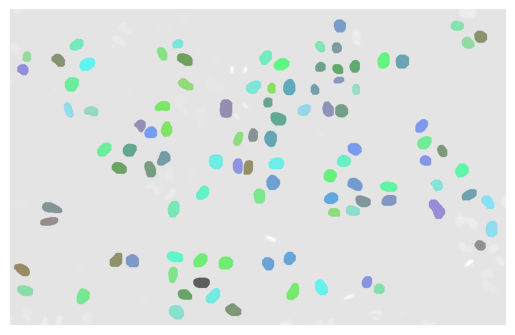

In [29]:
from torchvision.utils import draw_segmentation_masks
import matplotlib.pyplot as plt

model.eval()
img, _ = val_ds[0]
with torch.no_grad():
    pred = model([img.to(device)])[0]

masks = pred["masks"] > 0.5
viz   = draw_segmentation_masks((img*255).byte().cpu(), masks.squeeze(1),
                                alpha=0.6)
plt.imshow(viz.permute(1,2,0),cmap="gray"); plt.axis("off")

In [44]:
import torch, numpy as np
from tqdm import tqdm

def mask_iou(a, b):
    inter = (a & b).sum()
    union = (a | b).sum()
    return 0 if union == 0 else inter / union

def evaluate_partial_labels(model, loader, device, iou_th=0.5):
    model.eval()
    total_gt, matched_gt, iou_sum = 0, 0, 0

    with torch.no_grad():
        for imgs, targets in tqdm(loader, desc="Eval"):
            imgs     = [im.to(device) for im in imgs]
            outputs  = model(imgs)

            # loop per‑image
            for out, tgt in zip(outputs, targets):
                gt_masks   = tgt["masks"].cpu().numpy().astype(bool)   # N_gt×H×W
                pred_masks = (out["masks"] > 0.5).cpu().numpy().astype(bool)

                total_gt += len(gt_masks)
                used_pred = set()

                # match each GT to first pred with IoU ≥ thresh
                for g in gt_masks:
                    best = -1
                    for j, p in enumerate(pred_masks):
                        if j in used_pred:            # one‑to‑one match
                            continue
                        iou = mask_iou(g, p)
                        if iou >= iou_th:
                            best = j; best_iou = iou; break
                    if best != -1:
                        matched_gt += 1
                        iou_sum += best_iou
                        used_pred.add(best)

    recall = matched_gt / total_gt if total_gt else 0
    mean_iou = iou_sum / matched_gt if matched_gt else 0
    return {"recall": recall, "mean_iou": mean_iou}

In [47]:
evaluate_partial_labels(model, val_loader, device, 0.5)

Eval: 100%|██████████| 18/18 [04:15<00:00, 14.19s/it]


{'recall': 0.38448386407352, 'mean_iou': 0.9163149465862482}

In [48]:
# recall = evaluate_recall(model, val_loader, device, iou_thresh=0.5)

18

Visualising:   0%|          | 0/18 [00:00<?, ?it/s]

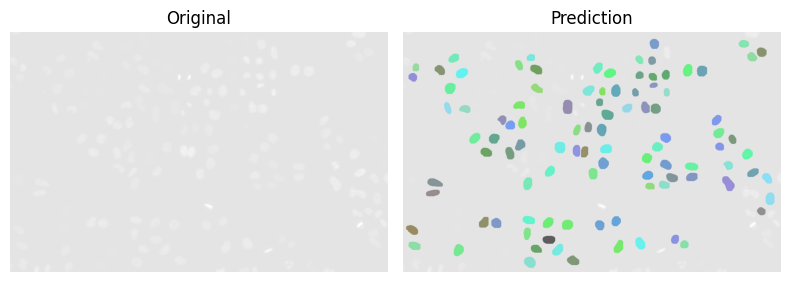

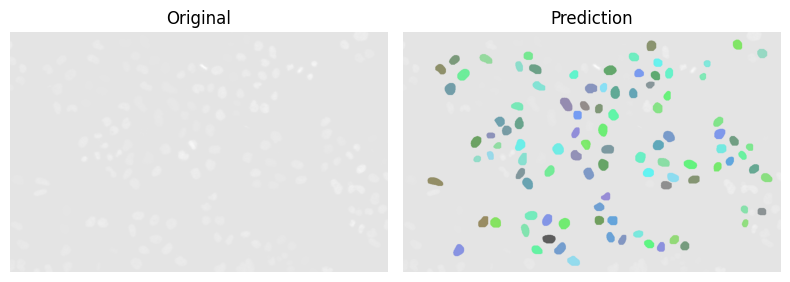

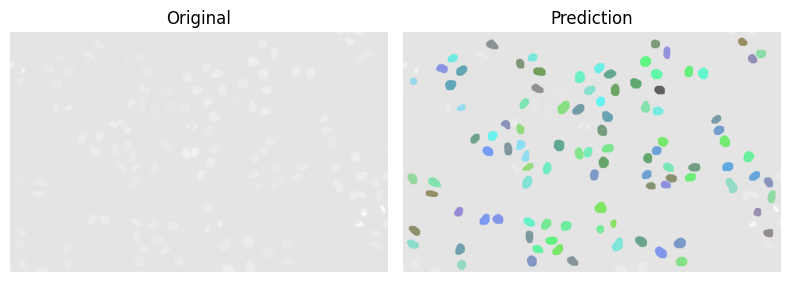

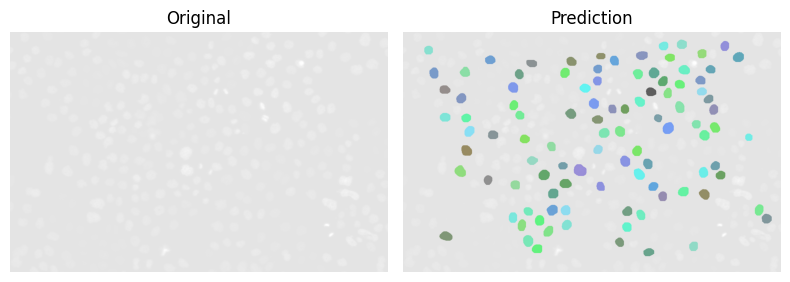

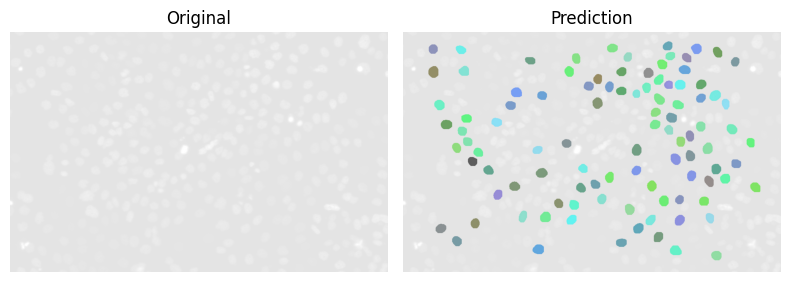

...

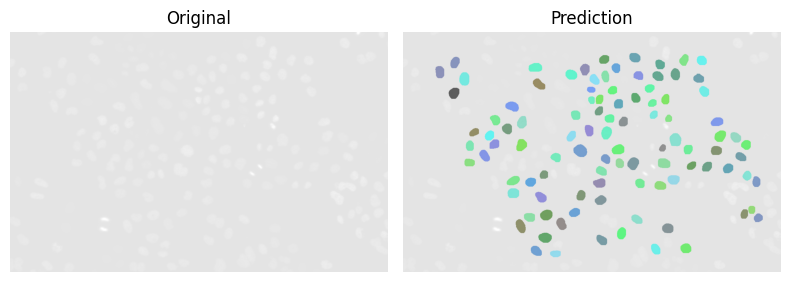

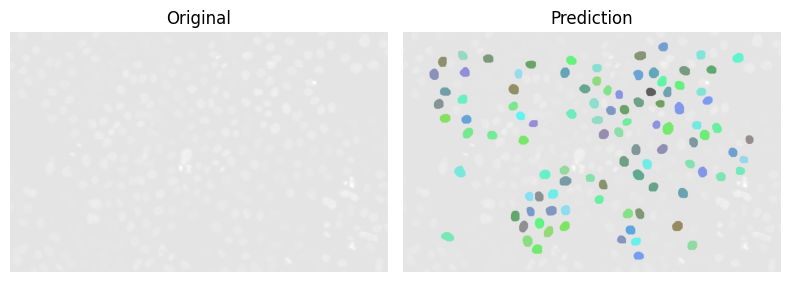

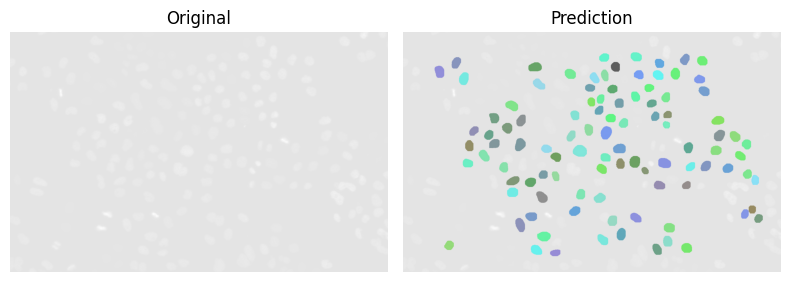

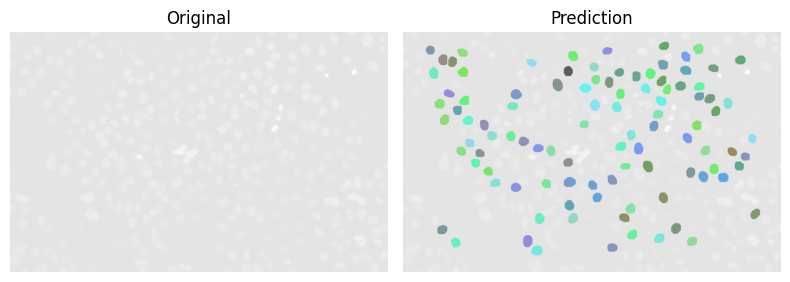

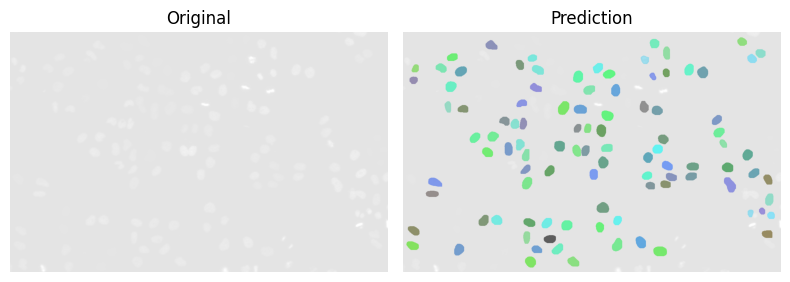

In [49]:
from torchvision.utils import draw_segmentation_masks
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import os, torch

# --------------------------------------------------
# OPTIONAL: folder to save PNGs instead of / in
# addition to showing them in‑line.  Comment out if
# you don't need the files.
# --------------------------------------------------
save_dir = "hela_preds"
os.makedirs(save_dir, exist_ok=True)

model.eval()
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# loop through the *validation* dataset
for idx in tqdm(range(len(val_ds)), desc="Visualising"):
    img, _ = val_ds[idx]                 # img is C×H×W, float32 0‑1
    with torch.no_grad():
        pred = model([img.to(device)])[0]

    # binarise masks (you can tweak 0.5 → 0.3 if masks look too small)
    masks = (pred["masks"] > 0.5).squeeze(1).cpu()

    # overlay masks on a copy of the image (convert to byte 0‑255 first)
    overlay = draw_segmentation_masks(
        (img * 255).byte(), masks, alpha=0.6
    )

    # ----------- 2‑panel figure --------------------
    fig, axes = plt.subplots(1, 2, figsize=(8, 4))
    # left = raw
    axes[0].imshow(img.permute(1, 2, 0), cmap="gray")
    axes[0].set_title("Original")
    axes[0].axis("off")
    # right = overlay
    axes[1].imshow(overlay.permute(1, 2, 0))
    axes[1].set_title("Prediction")
    axes[1].axis("off")
    plt.tight_layout()

    # save as PNG if desired
    fig.savefig(os.path.join(save_dir, f"pred_{idx:03d}.png"), dpi=150)
    plt.show()          # comment out if you only want files
    plt.close(fig)

Visualising:   0%|          | 0/18 [00:00<?, ?it/s]

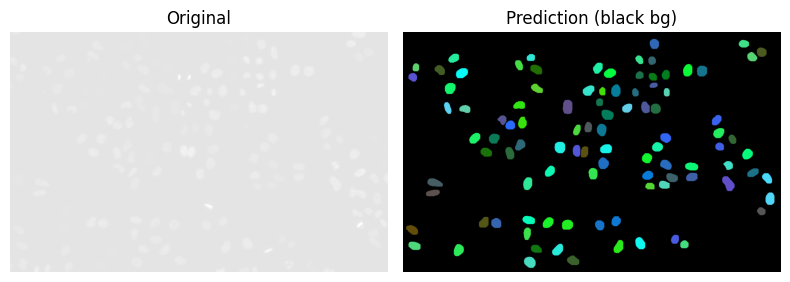

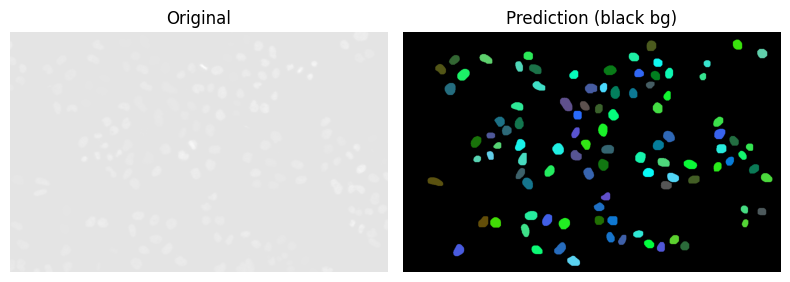

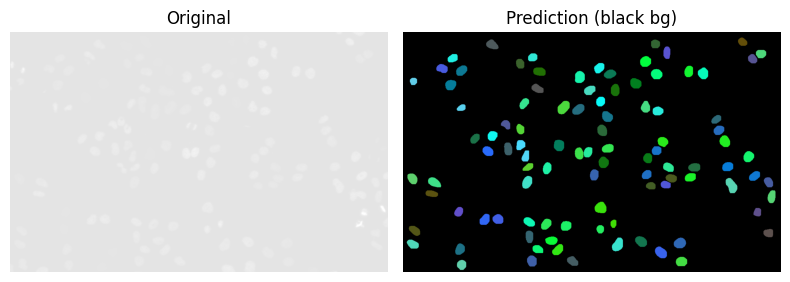

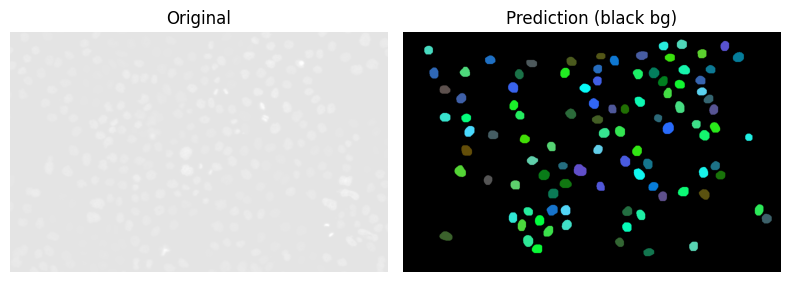

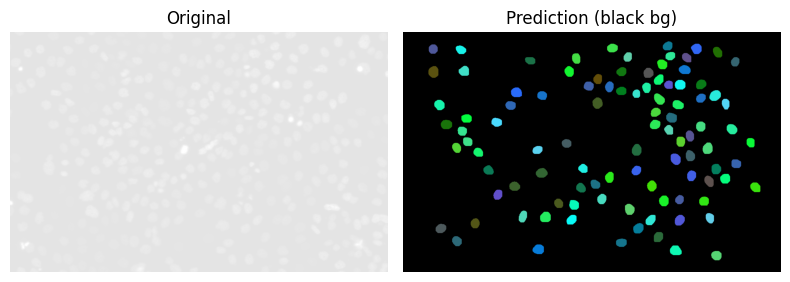

...

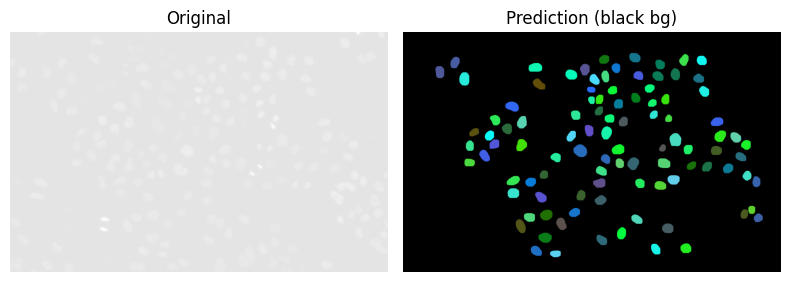

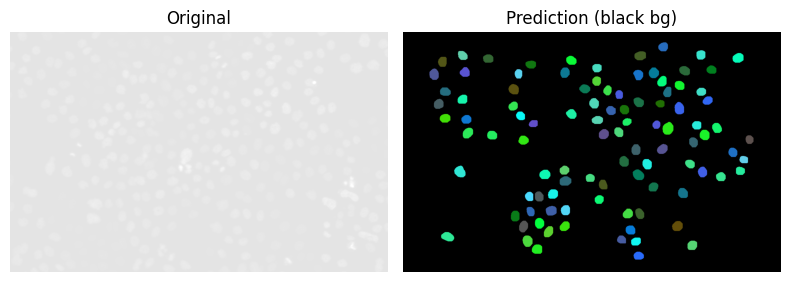

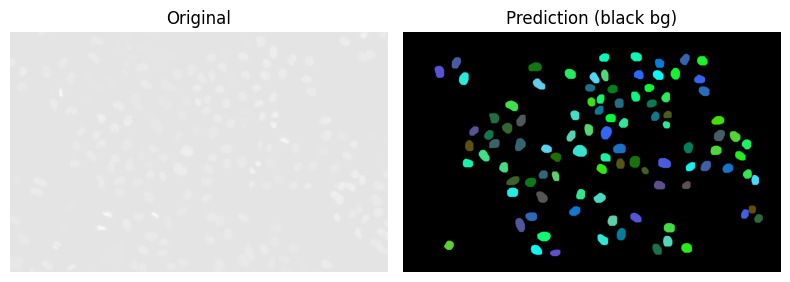

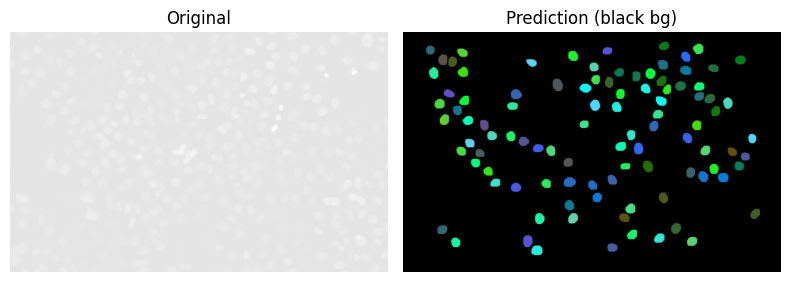

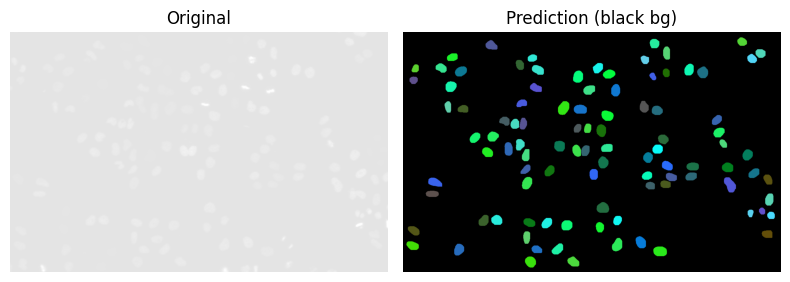

In [58]:
from torchvision.utils import draw_segmentation_masks
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import os, torch

save_dir = "hela_black_bg"
os.makedirs(save_dir, exist_ok=True)

model.eval()
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

for idx in tqdm(range(len(val_ds)), desc="Visualising"):
    img, _ = val_ds[idx]                       # C×H×W, float32 0‑1
    with torch.no_grad():
        pred = model([img.to(device)])[0]

    # binarise masks
    masks = (pred["masks"] > 0.5).squeeze(1).cpu()

    # --------  build black canvas & paint masks ----------
    H, W = img.shape[1:]
    black_canvas = torch.zeros((3, H, W), dtype=torch.uint8)  # all black
    color_overlay = draw_segmentation_masks(
        black_canvas.clone(),         # draw on a copy
        masks,
        alpha=1.0,                    # fully opaque masks
        colors=None                   # random distinct colors
    )

    # ------------- side‑by‑side figure --------------------
    fig, axes = plt.subplots(1, 2, figsize=(8, 4))
    # original
    axes[0].imshow(img.permute(1, 2, 0), cmap="gray")
    axes[0].set_title("Original")
    axes[0].axis("off")
    # prediction on black
    axes[1].imshow(color_overlay.permute(1, 2, 0))
    axes[1].set_title("Prediction (black bg)")
    axes[1].axis("off")
    plt.tight_layout()

    fig.savefig(os.path.join(save_dir, f"pred_black_{idx:03d}.png"), dpi=150)
    plt.show()
    plt.close(fig)


In [8]:
# train_mask_rcnn.py
import torch, torchvision
from torch.utils.data import DataLoader, random_split
# from nucleus_dataset import NucleusDataset, get_augs
# from model_utils   import get_instance_seg_model
# from engine        import train_one_epoch, evaluate

# root = "/kaggle/input/fluo-n2dl-hela/Fluo-Structured-2/Fluo-Structured-2"                      # ← adjust
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print("device",device)


# — datasets & loaders —
full_ds   = NucleusDataset(root, transforms=get_augs(train=True))
val_size  = max(1, int(0.2*len(full_ds)))
train_ds, val_ds = random_split(full_ds, [len(full_ds)-val_size, val_size])

train_ds.dataset.transforms = get_augs(train=True)  # augment
val_ds.dataset.transforms   = get_augs(train=False) # no augment

def collate(batch): return list(zip(*batch))
train_loader = DataLoader(train_ds, batch_size=2, shuffle=True,
                          collate_fn=collate, num_workers=2)
val_loader   = DataLoader(val_ds,   batch_size=1, shuffle=False,
                          collate_fn=collate, num_workers=2)

# — model —
model = get_instance_seg_model(num_classes=2).to(device)

# 2️⃣  Load the weights
checkpoint_path = "/kaggle/working/maskrcnn_hela.pth"   # adjust if needed
state = torch.load(checkpoint_path, map_location=device) # or "cuda"
model.load_state_dict(state, strict=True)               # strict=False if you tweaked layers later

# 3️⃣  Move to device and pick mode
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)
model.eval()       # inference mode  (use model.train() if you’ll keep fine‑tuning)

print("✅ weights loaded, model ready for inference!")


device cuda:0


/tmp/ipykernel_687/3446425939.py:28: UserWarning: Argument(s) 'alpha_affine' are not valid for transform ElasticTransform
  A.ElasticTransform(alpha=20, sigma=3, alpha_affine=10, p=0.3),
/tmp/ipykernel_687/3446425939.py:30: UserWarning: Argument(s) 'var_limit' are not valid for transform GaussNoise
  A.GaussNoise(var_limit=(5,20), p=0.3),


✅ weights loaded, model ready for inference!


Visualising:   0%|          | 0/18 [00:00<?, ?it/s]

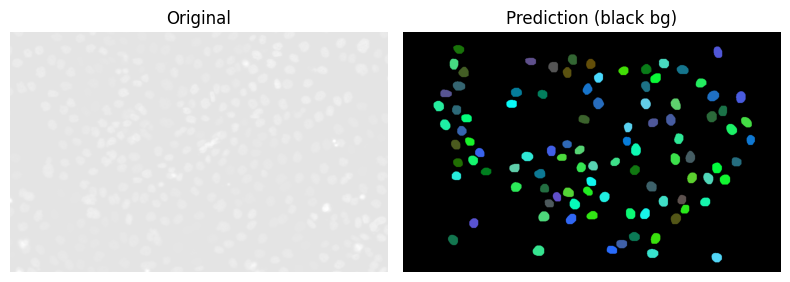

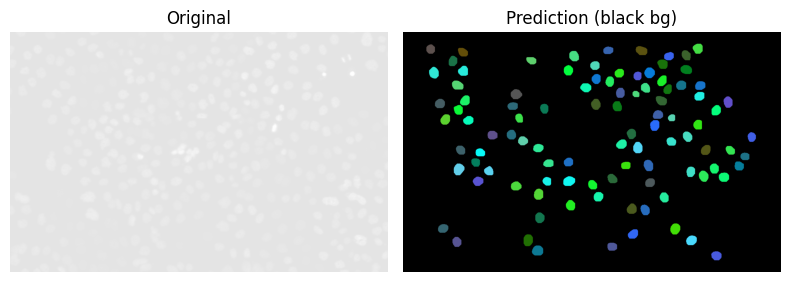

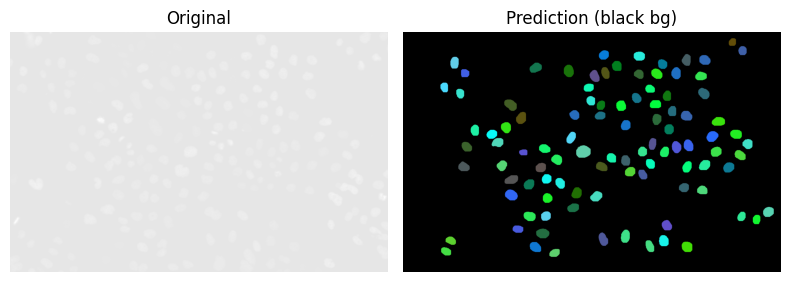

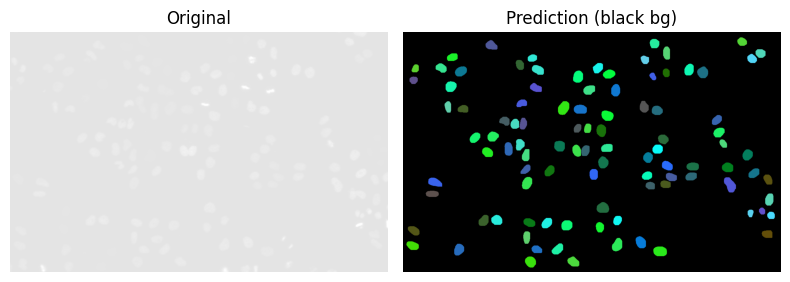

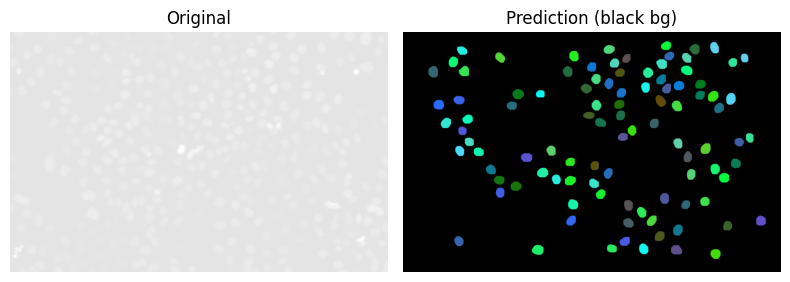

...

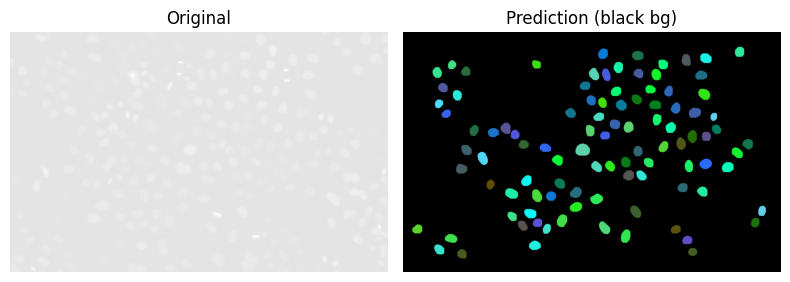

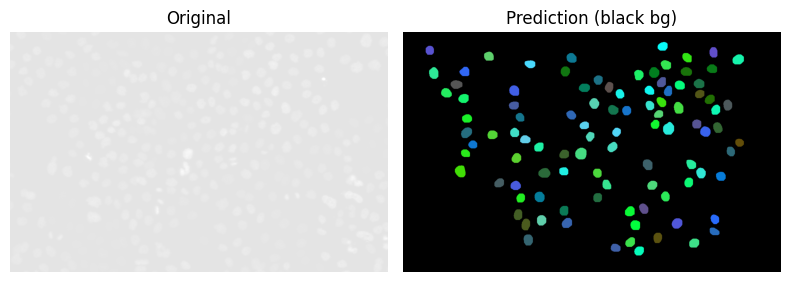

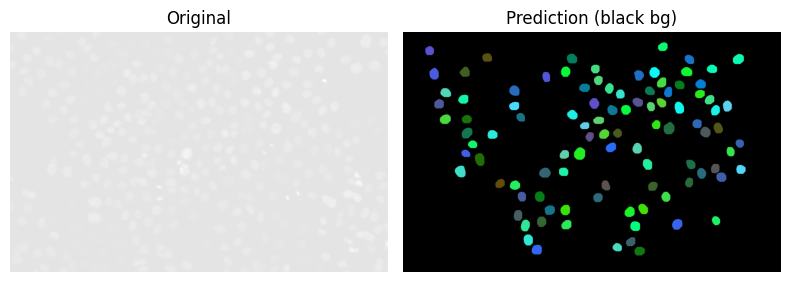

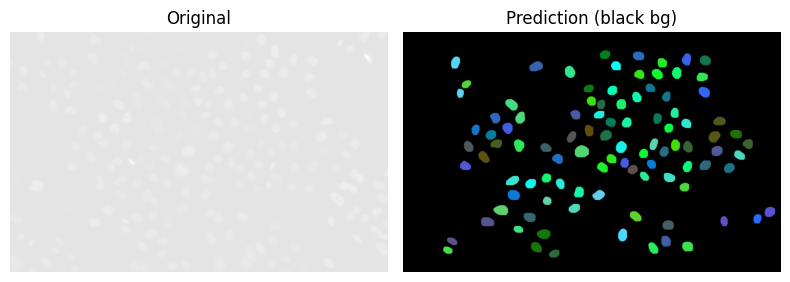

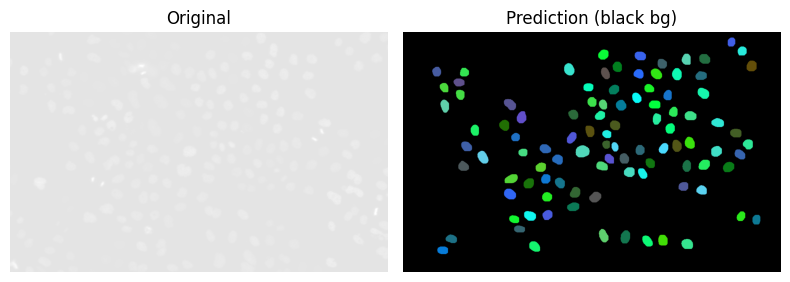

In [9]:
from torchvision.utils import draw_segmentation_masks
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import os, torch

save_dir = "hela_black_bg"
os.makedirs(save_dir, exist_ok=True)

model.eval()
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

for idx in tqdm(range(len(val_ds)), desc="Visualising"):
    img, _ = val_ds[idx]                       # C×H×W, float32 0‑1
    with torch.no_grad():
        pred = model([img.to(device)])[0]

    # binarise masks
    masks = (pred["masks"] > 0.5).squeeze(1).cpu()

    # --------  build black canvas & paint masks ----------
    H, W = img.shape[1:]
    black_canvas = torch.zeros((3, H, W), dtype=torch.uint8)  # all black
    color_overlay = draw_segmentation_masks(
        black_canvas.clone(),         # draw on a copy
        masks,
        alpha=1.0,                    # fully opaque masks
        colors=None                   # random distinct colors
    )

    # ------------- side‑by‑side figure --------------------
    fig, axes = plt.subplots(1, 2, figsize=(8, 4))
    # original
    axes[0].imshow(img.permute(1, 2, 0), cmap="gray")
    axes[0].set_title("Original")
    axes[0].axis("off")
    # prediction on black
    axes[1].imshow(color_overlay.permute(1, 2, 0))
    axes[1].set_title("Prediction (black bg)")
    axes[1].axis("off")
    plt.tight_layout()

    fig.savefig(os.path.join(save_dir, f"pred_black_{idx:03d}.png"), dpi=150)
    plt.show()
    plt.close(fig)


Visualizing folder images:   0%|          | 0/92 [00:00<?, ?it/s]

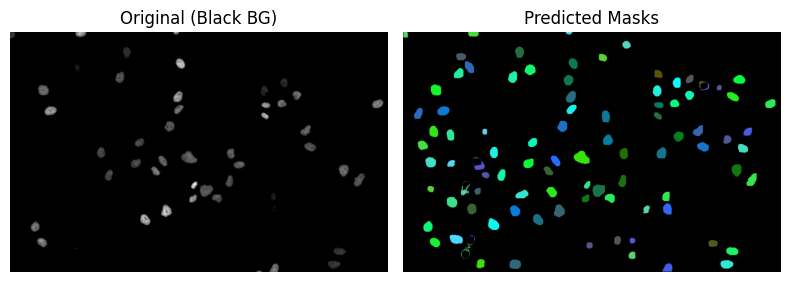

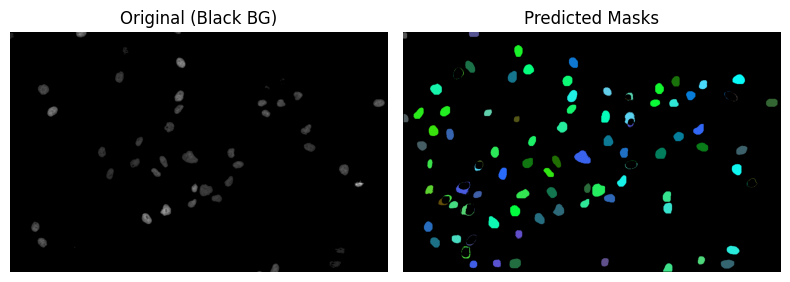

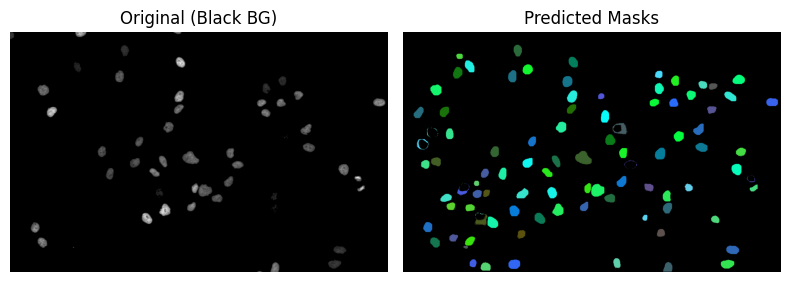

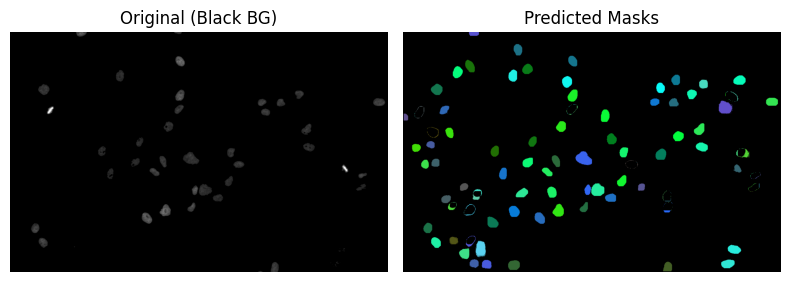

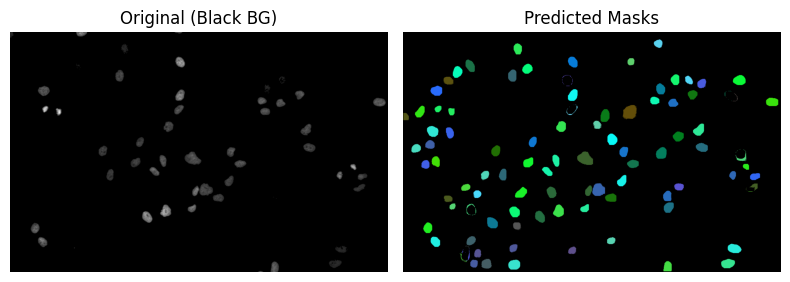

...

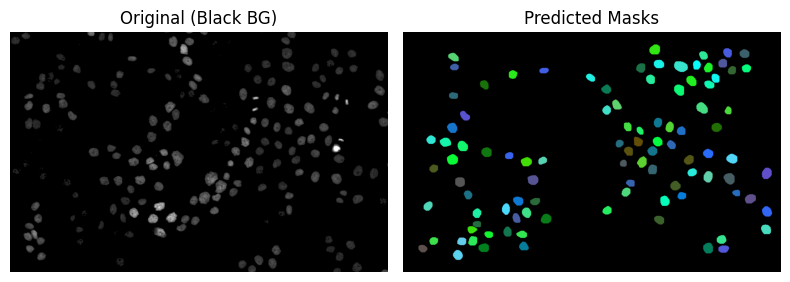

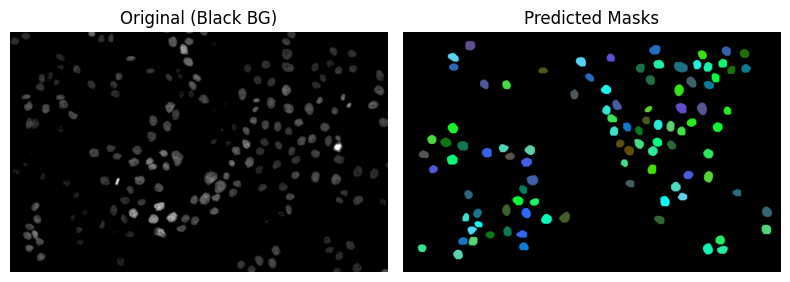

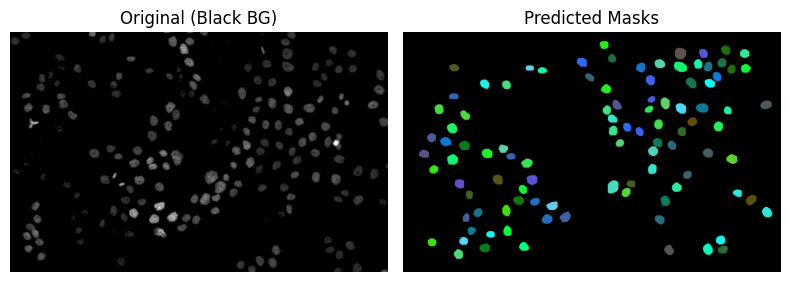

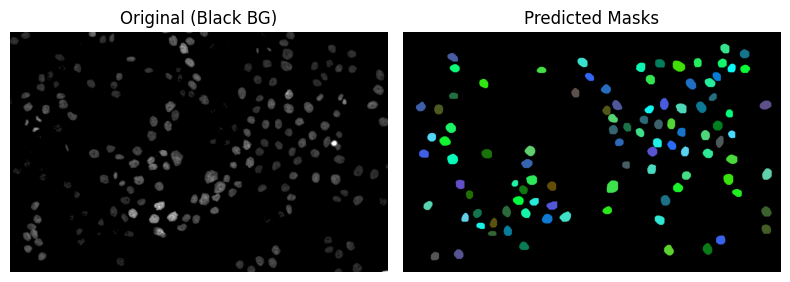

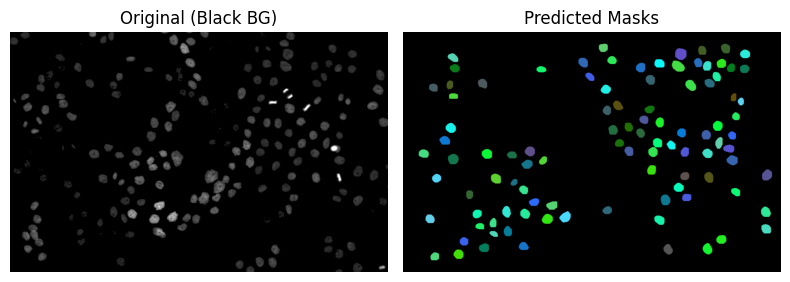

In [29]:
import os
from skimage import io
import torchvision.transforms as T
import torch
import torch.nn.functional as F
from torchvision.utils import draw_segmentation_masks
import matplotlib.pyplot as plt
from tqdm.auto import tqdm

image_folder = "/kaggle/input/fluo-n2dl-hela/Fluo-N2DL-HeLa_test/Fluo-N2DL-HeLa/01"
image_files = sorted([f for f in os.listdir(image_folder) if f.endswith(".tif")])

model.eval()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
save_dir = "hela_black_on_black_test"
os.makedirs(save_dir, exist_ok=True)

for idx, filename in enumerate(tqdm(image_files, desc="Visualizing folder images")):
    # ✅ Use skimage to preserve actual grayscale range (e.g., 16-bit)
    img_np = io.imread(os.path.join(image_folder, filename))  # shape: (H, W), dtype: uint16 or float

    # 🔁 Normalize to [0,1] and convert to tensor
    img_tensor = torch.tensor(img_np, dtype=torch.float32)
    img_tensor -= img_tensor.min()
    if img_tensor.max() > 0:
        img_tensor /= img_tensor.max()
    img = img_tensor.unsqueeze(0)  # (1, H, W)

    with torch.no_grad():
        pred = model([img.to(device)])[0]

    # 🔍 Predicted masks
    masks = (pred["masks"] > 0.5).squeeze(1).cpu()

    # 🖤 Black background version of original image
    gray_img = (img * 255).byte().squeeze(0).clone()  # (H, W)
    threshold = 30
    gray_img[gray_img < threshold] = 0
    gray_rgb = torch.stack([gray_img]*3, dim=0)  # (3, H, W)

    H, W = gray_rgb.shape[1:]
    if masks.shape[-2:] != (H, W):
        masks = F.interpolate(masks.unsqueeze(1).float(), size=(H, W), mode='nearest').squeeze(1).bool()

    black_canvas = torch.zeros((3, H, W), dtype=torch.uint8)
    overlay = draw_segmentation_masks(black_canvas.clone(), masks, alpha=1.0, colors=None)

    # 🖼️ Plot
    fig, axes = plt.subplots(1, 2, figsize=(8, 4))
    axes[0].imshow(gray_rgb.permute(1, 2, 0))
    axes[0].set_title("Original (Black BG)")
    axes[0].axis("off")

    axes[1].imshow(overlay.permute(1, 2, 0))
    axes[1].set_title("Predicted Masks")
    axes[1].axis("off")
    plt.tight_layout()

    fig.savefig(os.path.join(save_dir, f"pred_{idx:03d}.png"), dpi=150)
    plt.show()
    plt.close(fig)


Visualising:   0%|          | 0/92 [00:00<?, ?it/s]

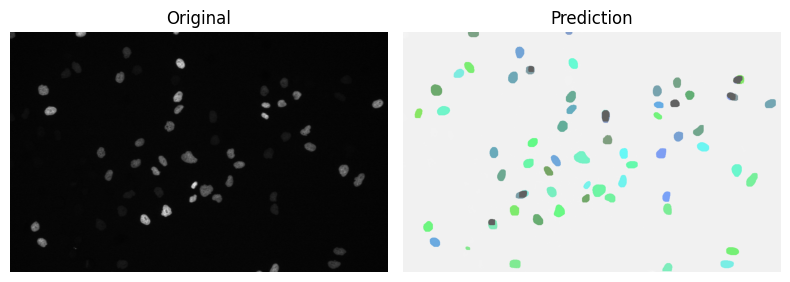

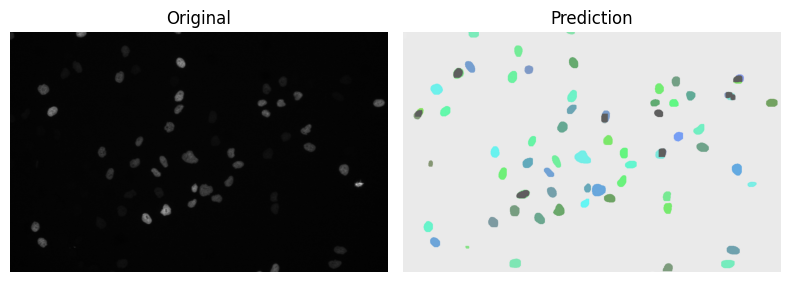

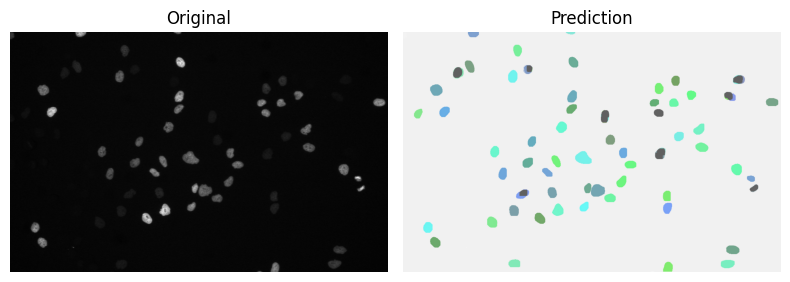

KeyboardInterrupt: 

In [34]:
from skimage import io                     # keeps original .tif intensity
import torch
import torch.nn.functional as F
from torchvision.utils import draw_segmentation_masks
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import os

# ------------------------------------------------------------------
# 1.  Paths
# ------------------------------------------------------------------
image_folder = "/kaggle/input/fluo-n2dl-hela/Fluo-N2DL-HeLa_test/Fluo-N2DL-HeLa/01"
image_files  = sorted([f for f in os.listdir(image_folder) if f.endswith(".tif")])

save_dir = "hela_preds"                    # where PNGs will be saved
os.makedirs(save_dir, exist_ok=True)

# ------------------------------------------------------------------
# 2.  Model ready
# ------------------------------------------------------------------
model.eval()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ------------------------------------------------------------------
# 3.  Loop over every image
# ------------------------------------------------------------------
for idx, fname in enumerate(tqdm(image_files, desc="Visualising")):
    # --- read image, keep original grayscale values --------------------
    img_np = io.imread(os.path.join(image_folder, fname))       # (H,W), uint16 or uint8
    img_tensor = torch.as_tensor(img_np, dtype=torch.float32)
    if img_tensor.max() > 0:
        img_tensor /= img_tensor.max()                          # scale 0‑1 (float32)
    img = img_tensor.unsqueeze(0)                               # (1,H,W)

    # --- model prediction ---------------------------------------------
    with torch.no_grad():
        pred = model([img.to(device)])[0]

    masks = (pred["masks"] > 0.5).squeeze(1).cpu()              # (N,H,W) bool

    # --- prepare image for mask overlay -------------------------------
    img3 = img.repeat(3, 1, 1)                                  # (3,H,W) for utils
    H, W = img3.shape[1:]

    # resize masks if needed
    if masks.shape[-2:] != (H, W):
        masks = F.interpolate(masks.unsqueeze(1).float(),
                              size=(H, W), mode='nearest').squeeze(1).bool()

    overlay = draw_segmentation_masks(
        (img3 * 255).byte(), masks, alpha=0.6                   # alpha=0.6 like before
    )

    # --- side‑by‑side figure ------------------------------------------
    fig, axes = plt.subplots(1, 2, figsize=(8, 4))
    # left: raw grayscale
    axes[0].imshow(img.squeeze(0), cmap="gray")
    axes[0].set_title("Original")
    axes[0].axis("off")
    # right: overlay
    axes[1].imshow(overlay.permute(1, 2, 0))
    axes[1].set_title("Prediction")
    axes[1].axis("off")
    plt.tight_layout()

    # save PNG (optional)
    fig.savefig(os.path.join(save_dir, f"pred_{idx:03d}.png"), dpi=150)
    plt.show()            # comment out if you only want files
    plt.close(fig)


In [27]:
val_ds[0][0]

tensor([[[0.8972, 0.8969, 0.8968,  ..., 0.9054, 0.9010, 0.8980],
         [0.8965, 0.8964, 0.8968,  ..., 0.9080, 0.9030, 0.8990],
         [0.8967, 0.8968, 0.8970,  ..., 0.9093, 0.9046, 0.9001],
         ...,
         [0.8968, 0.8969, 0.8971,  ..., 0.9028, 0.9079, 0.9118],
         [0.8965, 0.8965, 0.8965,  ..., 0.9019, 0.9056, 0.9101],
         [0.8966, 0.8965, 0.8968,  ..., 0.9013, 0.9046, 0.9077]],

        [[0.8972, 0.8969, 0.8968,  ..., 0.9054, 0.9010, 0.8980],
         [0.8965, 0.8964, 0.8968,  ..., 0.9080, 0.9030, 0.8990],
         [0.8967, 0.8968, 0.8970,  ..., 0.9093, 0.9046, 0.9001],
         ...,
         [0.8968, 0.8969, 0.8971,  ..., 0.9028, 0.9079, 0.9118],
         [0.8965, 0.8965, 0.8965,  ..., 0.9019, 0.9056, 0.9101],
         [0.8966, 0.8965, 0.8968,  ..., 0.9013, 0.9046, 0.9077]],

        [[0.8972, 0.8969, 0.8968,  ..., 0.9054, 0.9010, 0.8980],
         [0.8965, 0.8964, 0.8968,  ..., 0.9080, 0.9030, 0.8990],
         [0.8967, 0.8968, 0.8970,  ..., 0.9093, 0.9046, 0.

Visualising:   0%|          | 0/92 [00:00<?, ?it/s]

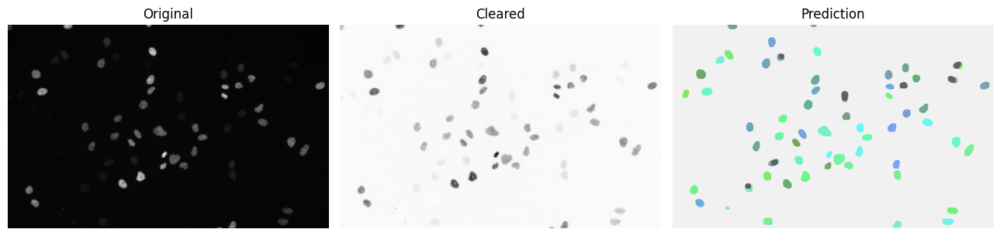

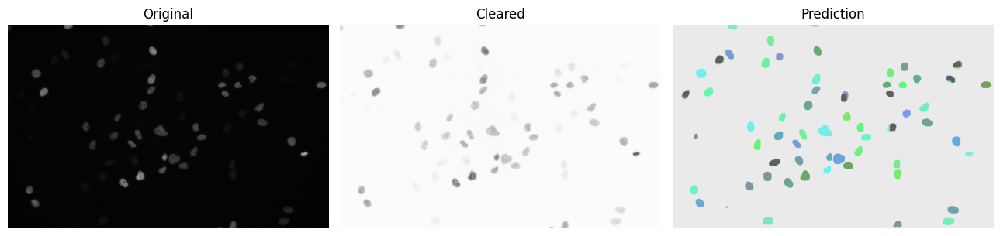

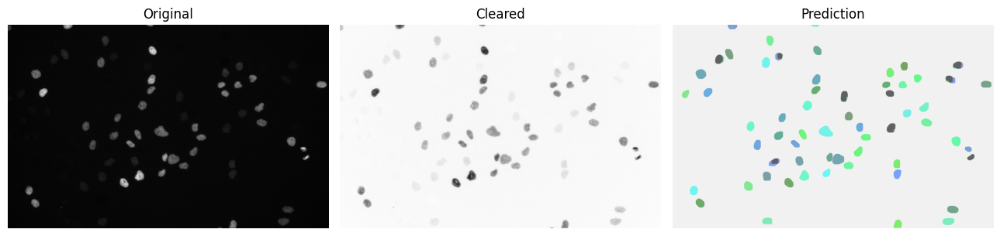

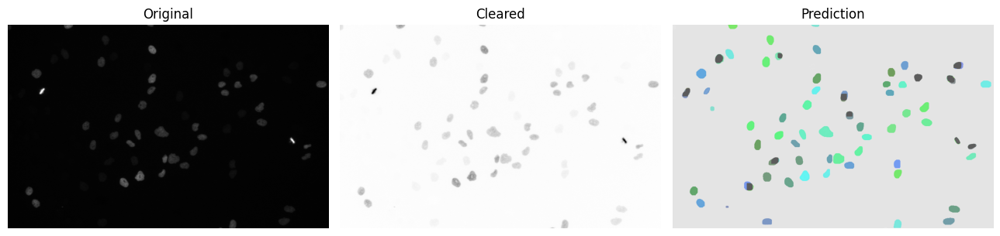

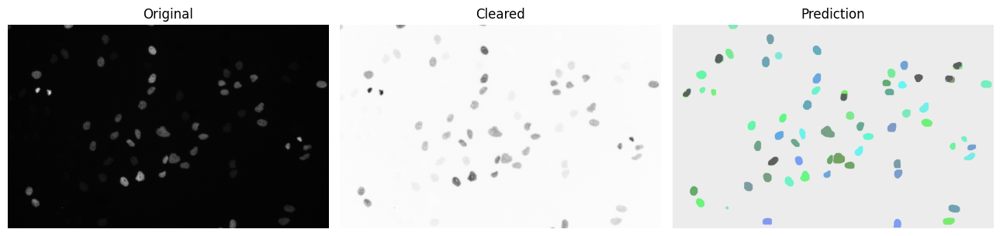

...

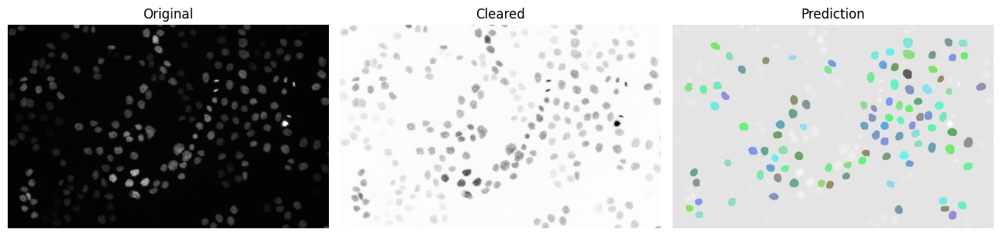

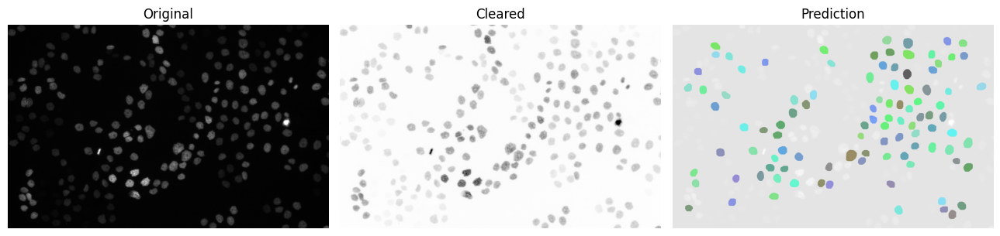

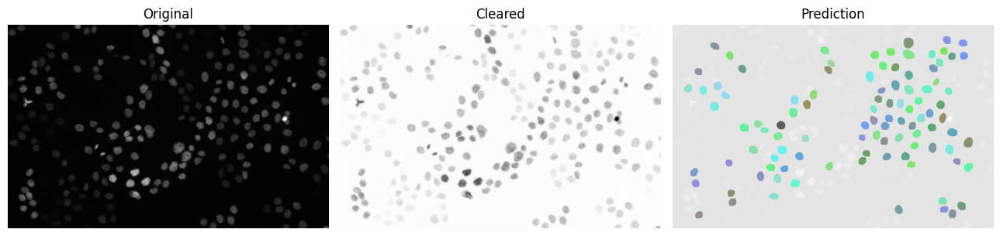

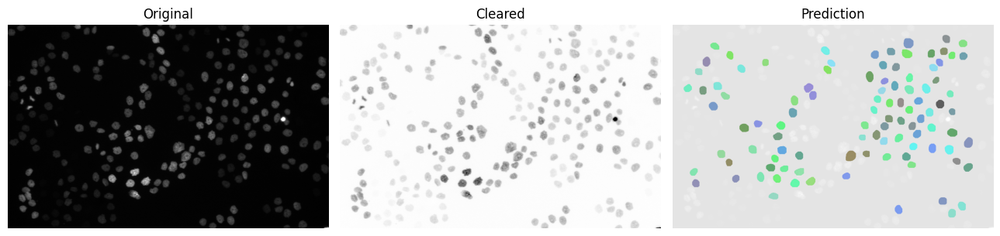

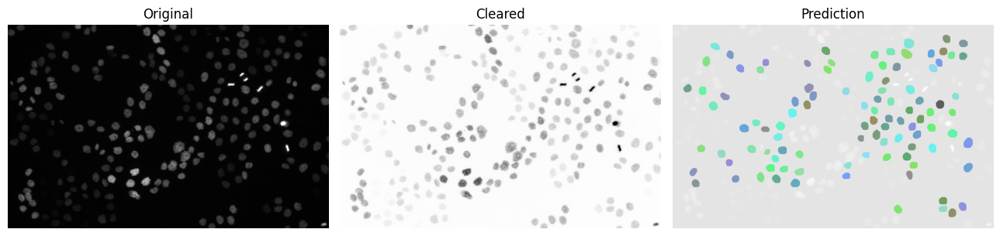

In [63]:
from skimage import io                     # keeps original .tif intensity
import torch
import torch.nn.functional as F
from torchvision.utils import draw_segmentation_masks
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import os

# ------------------------------------------------------------------
# 1.  Paths
# ------------------------------------------------------------------
image_folder = "/kaggle/input/fluo-n2dl-hela/Fluo-N2DL-HeLa_test/Fluo-N2DL-HeLa/01"
image_files  = sorted([f for f in os.listdir(image_folder) if f.endswith(".tif")])

save_dir = "hela_preds"                    # where PNGs will be saved
os.makedirs(save_dir, exist_ok=True)

# ------------------------------------------------------------------
# 2.  Model ready
# ------------------------------------------------------------------
model.eval()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ------------------------------------------------------------------
# 3.  Loop over every image
# ------------------------------------------------------------------
for idx, fname in enumerate(tqdm(image_files, desc="Visualising")):
    # --- read image, keep original grayscale values --------------------
    img_np = io.imread(os.path.join(image_folder, fname))       # (H,W), uint16 or uint8
    img_tensor = torch.as_tensor(img_np, dtype=torch.float32)
    if img_tensor.max() > 0:
        img_tensor /= img_tensor.max()                          # scale 0‑1 (float32)
    img = img_tensor.unsqueeze(0)                               # (1,H,W)

    # --- model prediction ---------------------------------------------
    with torch.no_grad():
        pred = model([img.to(device)])[0]

    masks = (pred["masks"] > 0.5).squeeze(1).cpu()              # (N,H,W) bool

    # --- prepare image for mask overlay -------------------------------
    img3 = img.repeat(3, 1, 1)                                  # (3,H,W) for utils
    H, W = img3.shape[1:]

    # resize masks if needed
    if masks.shape[-2:] != (H, W):
        masks = F.interpolate(masks.unsqueeze(1).float(),
                              size=(H, W), mode='nearest').squeeze(1).bool()

    overlay = draw_segmentation_masks(
        (img3 * 255).byte(), masks, alpha=0.6                   # alpha=0.6 like before
    )

    # --- side‑by‑side figure ------------------------------------------
    fig, axes = plt.subplots(1, 3, figsize=(13, 13))
    # left: raw grayscale
    clear_img = (1 - img.squeeze(0)) * 255.0
    # clear_img = np.where(clear_img >=clear_img.max(), 1,0)
    # print(clear_img.unique())
    # print(clear_img.median())

    
    axes[0].imshow(img.squeeze(0), cmap="gray")
    axes[0].set_title("Original")
    axes[0].axis("off")
    
    axes[1].imshow(clear_img, cmap="gray")
    axes[1].set_title("Cleared")
    axes[1].axis("off")
    
    # right: overlay
    axes[2].imshow(overlay.permute(1, 2, 0))
    axes[2].set_title("Prediction")
    axes[2].axis("off")
    plt.tight_layout()

    # save PNG (optional)
    fig.savefig(os.path.join(save_dir, f"pred_{idx:03d}.png"), dpi=150)
    plt.show()            # comment out if you only want files
    plt.close(fig)


# Track

In [68]:
import os, torch, numpy as np, cv2
from glob import glob
from skimage import io
from tqdm.auto import tqdm
from torchvision.ops import masks_to_boxes


image_folder = "/kaggle/input/fluo-n2dl-hela/Fluo-N2DL-HeLa_train/Fluo-N2DL-HeLa/"
image_files  = sorted(glob(os.path.join(image_folder, "01", "*.tif")))


# --------------- 4. output folders --------------------------------
out_dir = "out_masks"
os.makedirs(out_dir, exist_ok=True)

# --------------- 5. helper: masks -> labelled array ---------------
def instance_mask_from_logits(logits, score_thr=0.5):
    """
    logits: Tensor shape [N, 1, H, W] (output of model['masks'])
    returns a 2‑D numpy array (H, W) with 0=background and 1..K instance labels
    """
    if logits.numel() == 0:
        return np.zeros(logits.shape[-2:], np.uint16)

    prob_masks = logits.sigmoid().squeeze(1)          # [N, H, W]
    bin_masks  = prob_masks > score_thr
    H, W = bin_masks.shape[-2:]
    labeled = np.zeros((H, W), np.uint16)

    inst_id = 1
    for m in bin_masks.cpu().numpy():
        # optional: remove tiny masks
        if m.sum() < 50:
            continue
        labeled[m.astype(bool)] = inst_id
        inst_id += 1
    return labeled

# --------------- 6. main loop -------------------------------------
for i, img_path in enumerate(tqdm(image_files, desc="Segmenting")):
    # read image (keeps original 16‑bit range)
    img_np = io.imread(img_path)
    img_t  = torch.tensor(img_np, dtype=torch.float32)
    if img_t.max() > 0:
        img_t /= img_t.max()
    img_t = img_t.unsqueeze(0).to(device)             # [1, H, W]

    with torch.no_grad():
        pred = model([img_t])[0]

    # build instance‑label mask (0 = background)
    inst_mask = instance_mask_from_logits(pred["masks"], score_thr=0.5)

    # ------ save .npy mask ---------------------------------------
    np.save(os.path.join(out_dir, f"mask_{i:03d}.npy"), inst_mask)

    # ------ quick visual png -------------------------------------
    vis = (inst_mask.astype(np.uint8) * 25).clip(0, 255)  # colour‐map later
    cv2.imwrite(os.path.join(out_dir, f"mask_vis_{i:03d}.png"), vis)

    print(f"Processed frame {i+1}/{len(image_files)}")

print("All frames processed – masks saved to", out_dir)

Segmenting:   0%|          | 0/92 [00:00<?, ?it/s]

Processed frame 1/92
Processed frame 2/92
Processed frame 3/92
Processed frame 4/92
Processed frame 5/92
Processed frame 6/92
Processed frame 7/92
Processed frame 8/92
Processed frame 9/92
Processed frame 10/92
Processed frame 11/92
Processed frame 12/92
Processed frame 13/92
Processed frame 14/92
Processed frame 15/92
Processed frame 16/92
Processed frame 17/92
Processed frame 18/92
Processed frame 19/92
Processed frame 20/92
Processed frame 21/92
Processed frame 22/92
Processed frame 23/92
Processed frame 24/92
Processed frame 25/92
Processed frame 26/92
Processed frame 27/92
Processed frame 28/92
Processed frame 29/92
Processed frame 30/92
Processed frame 31/92
Processed frame 32/92
Processed frame 33/92
Processed frame 34/92
Processed frame 35/92
Processed frame 36/92
Processed frame 37/92
Processed frame 38/92
Processed frame 39/92
Processed frame 40/92
Processed frame 41/92
Processed frame 42/92
Processed frame 43/92
Processed frame 44/92
Processed frame 45/92
Processed frame 46/

In [95]:
import os, torch, numpy as np, cv2
from glob import glob
from skimage import io
from tqdm.auto import tqdm
from torchvision.ops import masks_to_boxes


image_folder = "/kaggle/input/fluo-n2dl-hela/Fluo-N2DL-HeLa_train/Fluo-N2DL-HeLa/"
image_files  = sorted(glob(os.path.join(image_folder, "01", "*.tif")))


# --------------- 4. output folders --------------------------------
out_dir = "out_masks"
os.makedirs(out_dir, exist_ok=True)



# ------------------------------------------------------------
# 4. Helper: tensor masks → labelled instance map
# ------------------------------------------------------------
def build_instance_map(bin_masks):
    """
    bin_masks: Bool tensor (N, H, W) where each slice is one instance.
    Returns uint16 2‑D array (H, W) with 0=background, 1..K = instance id.
    """
    if bin_masks.numel() == 0:
        H, W = bin_masks.shape[-2:]
        return np.zeros((H, W), np.uint16)

    labelled = np.zeros(bin_masks.shape[-2:], np.uint16)
    for inst_id, m in enumerate(bin_masks.cpu().numpy(), start=1):
        if m.sum() < 50:               # filter tiny specks (optional)
            continue
        labelled[m.astype(bool)] = inst_id
    return labelled

# ------------------------------------------------------------
# 5. Main loop – segment every frame
# ------------------------------------------------------------
for i, path in enumerate(tqdm(image_files, desc="Segmenting")):
    # -- read TIFF (keeps full dynamic range)
    img_np = io.imread(path)
    img_t  = torch.tensor(img_np, dtype=torch.float32, device=device)

    # normalise to 0‑1 per frame
    img_t -= img_t.min()
    if img_t.max() > 0:
        img_t /= img_t.max()

    img_t = img_t.unsqueeze(0)                       # (1, H, W)

    with torch.no_grad():
        pred = model([img_t])[0]

    # --- threshold masks exactly like your visual snippet -----------
    bin_masks = (pred["masks"] > 0.5).squeeze(1)     # Bool (N,H,W)

    # --- convert to single label map -------------------------------
    inst_map = build_instance_map(bin_masks)

    # save .npy for tracking
    np.save(os.path.join(out_dir, f"mask_{i:03d}.npy"), inst_map)

    # quick PNG visual: each id * 20 looks nice in grayscale
    vis = (inst_map.astype(np.uint8) * 20).clip(0, 255)
    cv2.imwrite(os.path.join(out_dir, f"mask_vis_{i:03d}.png"), vis)

    print(f"Frame {i+1}/{len(image_files)} done")

print("✓ All instance masks saved in", out_dir)

Segmenting:   0%|          | 0/92 [00:00<?, ?it/s]

Frame 1/92 done
Frame 2/92 done
Frame 3/92 done
Frame 4/92 done
Frame 5/92 done
Frame 6/92 done
Frame 7/92 done
Frame 8/92 done
Frame 9/92 done
Frame 10/92 done
Frame 11/92 done
Frame 12/92 done
Frame 13/92 done
Frame 14/92 done
Frame 15/92 done
Frame 16/92 done
Frame 17/92 done
Frame 18/92 done
Frame 19/92 done
Frame 20/92 done
Frame 21/92 done
Frame 22/92 done
Frame 23/92 done
Frame 24/92 done
Frame 25/92 done
Frame 26/92 done
Frame 27/92 done
Frame 28/92 done
Frame 29/92 done
Frame 30/92 done
Frame 31/92 done
Frame 32/92 done
Frame 33/92 done
Frame 34/92 done
Frame 35/92 done
Frame 36/92 done
Frame 37/92 done
Frame 38/92 done
Frame 39/92 done
Frame 40/92 done
Frame 41/92 done
Frame 42/92 done
Frame 43/92 done
Frame 44/92 done
Frame 45/92 done
Frame 46/92 done
Frame 47/92 done
Frame 48/92 done
Frame 49/92 done
Frame 50/92 done
Frame 51/92 done
Frame 52/92 done
Frame 53/92 done
Frame 54/92 done
Frame 55/92 done
Frame 56/92 done
Frame 57/92 done
Frame 58/92 done
Frame 59/92 done
Frame 

In [96]:
import numpy as np
import os
from scipy.optimize import linear_sum_assignment
from skimage.measure import regionprops
from scipy.spatial.distance import cdist

def iou(bb1, bb2):
    """Compute IoU between two bounding boxes"""
    x1 = max(bb1[0], bb2[0])
    y1 = max(bb1[1], bb2[1])
    x2 = min(bb1[2], bb2[2])
    y2 = min(bb1[3], bb2[3])

    inter_area = max(0, x2 - x1) * max(0, y2 - y1)
    bb1_area = (bb1[2] - bb1[0]) * (bb1[3] - bb1[1])
    bb2_area = (bb2[2] - bb2[0]) * (bb2[3] - bb2[1])

    return inter_area / float(bb1_area + bb2_area - inter_area + 1e-6)

def compute_bbox(mask):
    props = regionprops(mask)
    return [prop.bbox for prop in props], [prop.centroid for prop in props]

def mask_to_objects(mask):
    props = regionprops(mask)
    return [
        {'id': None, 'label': prop.label, 'centroid': prop.centroid, 'bbox': prop.bbox, 'area': prop.area}
        for prop in props
    ]

def track_cells(mask_list, iou_threshold=0.3):
    next_id = 1
    tracks = {}  # {id: [{frame, centroid, area}]}

    prev_objects = []

    for t, mask in enumerate(mask_list):
        curr_objects = mask_to_objects(mask)

        if t == 0:
            for obj in curr_objects:
                obj['id'] = next_id
                tracks[next_id] = [{'frame': t, **obj}]
                next_id += 1
        else:
            cost_matrix = np.ones((len(prev_objects), len(curr_objects))) * np.inf

            for i, prev in enumerate(prev_objects):
                for j, curr in enumerate(curr_objects):
                    cost_matrix[i, j] = 1 - iou(prev['bbox'], curr['bbox'])

            row_ind, col_ind = linear_sum_assignment(cost_matrix)

            assigned = set()
            for i, j in zip(row_ind, col_ind):
                if cost_matrix[i, j] < (1 - iou_threshold):
                    curr_objects[j]['id'] = prev_objects[i]['id']
                    tracks[prev_objects[i]['id']].append({'frame': t, **curr_objects[j]})
                    assigned.add(j)

            for j, curr in enumerate(curr_objects):
                if j not in assigned:
                    curr['id'] = next_id
                    tracks[next_id] = [{'frame': t, **curr}]
                    next_id += 1

        prev_objects = curr_objects

    return tracks


In [97]:
import numpy as np
import os
# from cell_tracker import track_cells


# Load all mask frames
mask_folder = 'out_masks'
mask_files = sorted([f for f in os.listdir(mask_folder) if f.endswith('.npy')])
masks = [np.load(os.path.join(mask_folder, f)) for f in mask_files]

tracks = track_cells(masks)

# Each track is a dictionary: ID → list of detections over time
print(f"Tracked {len(tracks)} unique cells.")


Tracked 1616 unique cells.


In [98]:
import numpy as np

def extract_features_from_tracks(tracks, pixel_size=1.0, frame_interval=1.0):
    feature_table = []

    for track_id, detections in tracks.items():
        sizes = [d['area'] for d in detections]
        centroids = np.array([d['centroid'] for d in detections])

        speeds = []
        for i in range(1, len(centroids)):
            dist = np.linalg.norm(np.array(centroids[i]) - np.array(centroids[i-1]))
            speed = (dist * pixel_size) / frame_interval
            speeds.append(speed)

        total_distance = np.sum(speeds) * frame_interval if speeds else 0

        feature_table.append({
            'id': track_id,
            'frames': [d['frame'] for d in detections],
            'mean_size': np.mean(sizes),
            'max_size': np.max(sizes),
            'min_size': np.min(sizes),
            'mean_speed': np.mean(speeds) if speeds else 0,
            'max_speed': np.max(speeds) if speeds else 0,
            'min_speed': np.min(speeds) if speeds else 0,
            'total_distance': total_distance
        })

    return feature_table


In [99]:
features = extract_features_from_tracks(tracks)

# Print a few examples
for f in features[:5]:
    print(f)

{'id': 1, 'frames': [0, 1, 2, 3, 4], 'mean_size': 519.0, 'max_size': 676.0, 'min_size': 47.0, 'mean_speed': 2.561103785520949, 'max_speed': 5.0796478572221995, 'min_speed': 0.1720108545541908, 'total_distance': 10.244415142083795}
{'id': 2, 'frames': [0, 1, 2, 3], 'mean_size': 566.75, 'max_size': 575.0, 'min_size': 559.0, 'mean_speed': 2.563883178527863, 'max_speed': 4.342108686996787, 'min_speed': 0.8238041225803263, 'total_distance': 7.691649535583588}
{'id': 3, 'frames': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14], 'mean_size': 600.6666666666666, 'max_size': 675.0, 'min_size': 499.0, 'mean_speed': 3.3573226670288485, 'max_speed': 7.753223253392695, 'min_speed': 1.0433245898581038, 'total_distance': 47.00251733840388}
{'id': 4, 'frames': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13], 'mean_size': 549.7857142857143, 'max_size': 660.0, 'min_size': 482.0, 'mean_speed': 3.126148813485512, 'max_speed': 6.563733391823197, 'min_speed': 0.6148786918937923, 'total_distance': 40.639934

In [100]:
import pandas as pd

def save_features_to_csv(features, filename="cell_features.csv"):
    df = pd.DataFrame(features)
    df.to_csv(filename, index=False)
    print(f"[✔] Cell features saved to: {filename}")

# Step 1: Extract features
features = extract_features_from_tracks(tracks)

# Step 2: Save to CSV
save_features_to_csv(features, "cell_features.csv")

[✔] Cell features saved to: cell_features.csv


In [101]:
def detect_mitosis(tracks, distance_threshold=20):
    mitosis_events = []

    track_endings = {}
    track_beginnings = {}

    for tid, dets in tracks.items():
        track_endings[tid] = dets[-1]
        track_beginnings[tid] = dets[0]

    for mother_id, end_det in track_endings.items():
        frame_end = end_det['frame']
        end_centroid = np.array(end_det['centroid'])

        # Find candidates starting in the next frame
        daughters = []
        for cand_id, start_det in track_beginnings.items():
            if cand_id == mother_id:
                continue
            if start_det['frame'] == frame_end + 1:
                dist = np.linalg.norm(end_centroid - np.array(start_det['centroid']))
                if dist < distance_threshold:
                    daughters.append((cand_id, dist))

        if len(daughters) >= 2:
            mitosis_events.append({
                'mother_id': mother_id,
                'frame': frame_end,
                'daughter_ids': [d[0] for d in daughters[:2]]
            })

    return mitosis_events


In [102]:
mitosis = detect_mitosis(tracks)
print(f"Detected {len(mitosis)} mitosis events.")

Detected 47 mitosis events.


In [103]:
import numpy as np
import cv2
import os
from matplotlib import cm
from skimage.measure import regionprops

def save_labeled_masks(tracks, original_masks, save_dir='labeled_masks_with_ids'):
    os.makedirs(save_dir, exist_ok=True)
    cmap = cm.get_cmap('tab20', 256)

    # Build label lookup: (frame, label) → track_id
    label_map = {}  # (frame, label) → track_id
    centroid_map = {}  # (frame, label) → centroid
    for tid, dets in tracks.items():
        for d in dets:
            label_map[(d['frame'], d['label'])] = tid
            centroid_map[(d['frame'], d['label'])] = d['centroid']

    for frame_idx, mask in enumerate(original_masks):
        h, w = mask.shape
        colored = np.zeros((h, w, 3), dtype=np.uint8)

        for label in np.unique(mask):
            if label == 0:
                continue

            key = (frame_idx, label)
            if key in label_map:
                tid = label_map[key]
                centroid = centroid_map[key]
                color = (np.array(cmap(tid % 256)[:3]) * 255).astype(np.uint8)

                # Color the mask
                colored[mask == label] = color

                # Draw the tracking ID as text
                cX, cY = int(centroid[1]), int(centroid[0])  # (row, col) → (x, y)
                cv2.putText(colored, str(tid), (cX, cY),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.5,
                            (255, 255, 255), 1, cv2.LINE_AA)

        out_path = os.path.join(save_dir, f"labeled_{frame_idx:03d}.png")
        cv2.imwrite(out_path, colored[:, :, ::-1])  # RGB → BGR

    print(f"[✔] Labeled masks with IDs saved to: {save_dir}")

In [104]:
def create_video_from_images(image_dir, output_file="tracked_cells.mp4", fps=5):
    image_files = sorted([f for f in os.listdir(image_dir) if f.endswith('.png')])
    if not image_files:
        print("No images found.")
        return

    first_img = cv2.imread(os.path.join(image_dir, image_files[0]))
    h, w, _ = first_img.shape

    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    video = cv2.VideoWriter(output_file, fourcc, fps, (w, h))

    for file in image_files:
        img = cv2.imread(os.path.join(image_dir, file))
        video.write(img)

    video.release()
    print(f"[✔] Video saved as: {output_file}")


In [105]:
# Example image shape (should match your original mask shape)
image_shape = masks[0].shape

# Step 1: Save labeled masks
# save_labeled_masks(tracks, shape=image_shape, save_dir='labeled_masks')
save_labeled_masks(tracks, original_masks=masks, save_dir="labeled_masks")

# Step 2: Convert labeled masks to video
create_video_from_images('labeled_masks', output_file='tracked_cells.mp4')

/tmp/ipykernel_687/2869839631.py:9: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('tab20', 256)


[✔] Labeled masks with IDs saved to: labeled_masks
[✔] Video saved as: tracked_cells.mp4


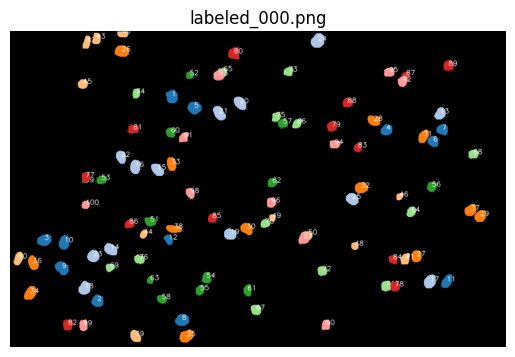

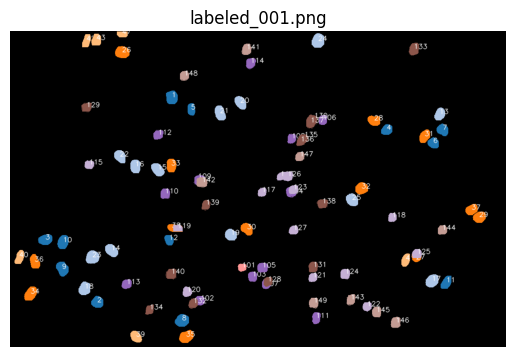

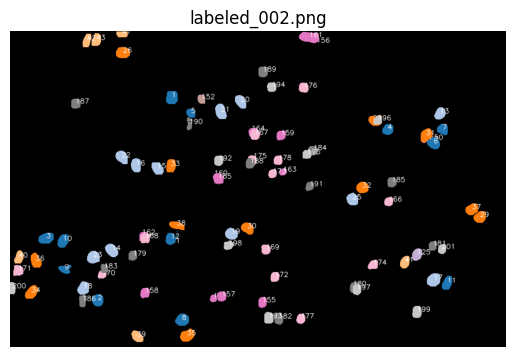

In [106]:
import matplotlib.pyplot as plt
import cv2
import os

image_dir = "labeled_masks"
files = sorted([f for f in os.listdir(image_dir) if f.endswith(".png")])

# Show first 3 images
for fname in files[:3]:
    img = cv2.imread(os.path.join(image_dir, fname))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title(fname)
    plt.axis('off')
    plt.show()


In [107]:
import numpy as np
import math

def extract_advanced_features(tracks, mitosis_events=[], pixel_size=1.0, frame_interval=1.0):
    mitosis_mothers = {m['mother_id'] for m in mitosis_events}
    mitosis_daughters = {d for m in mitosis_events for d in m['daughter_ids']}

    feature_table = []

    for track_id, detections in tracks.items():
        sizes = [d['area'] for d in detections]
        frames = [d['frame'] for d in detections]
        centroids = np.array([d['centroid'] for d in detections])

        speeds = []
        angles = []
        accelerations = []

        for i in range(1, len(centroids)):
            p1 = np.array(centroids[i - 1])
            p2 = np.array(centroids[i])
            dx, dy = p2[1] - p1[1], p2[0] - p1[0]

            dist = np.linalg.norm(p2 - p1)
            speed = (dist * pixel_size) / frame_interval
            speeds.append(speed)

            angle = math.degrees(math.atan2(-dy, dx)) % 360  # up is 90
            angles.append(angle)

        for i in range(1, len(speeds)):
            accel = (speeds[i] - speeds[i - 1]) / frame_interval
            accelerations.append(accel)

        feature_table.append({
            'id': track_id,
            'birth_frame': frames[0],
            'death_frame': frames[-1],
            'lifetime': len(frames),
            'mean_size': np.mean(sizes),
            'min_size': np.min(sizes),
            'max_size': np.max(sizes),
            'mean_speed': np.mean(speeds) if speeds else 0,
            'min_speed': np.min(speeds) if speeds else 0,
            'max_speed': np.max(speeds) if speeds else 0,
            'mean_acceleration': np.mean(accelerations) if accelerations else 0,
            'min_acceleration': np.min(accelerations) if accelerations else 0,
            'max_acceleration': np.max(accelerations) if accelerations else 0,
            'mean_angle': np.mean(angles) if angles else 0,
            'min_angle': np.min(angles) if angles else 0,
            'max_angle': np.max(angles) if angles else 0,
            'total_distance': np.sum(speeds) * frame_interval if speeds else 0,
            'mitosis_status': track_id in mitosis_mothers or track_id in mitosis_daughters,
            'role': ('mother' if track_id in mitosis_mothers else
                     'daughter' if track_id in mitosis_daughters else 'none')
        })

    return feature_table


In [108]:
advanced_features = extract_advanced_features(tracks, mitosis)
save_features_to_csv(advanced_features, "cell_advanced_features.csv")

[✔] Cell features saved to: cell_advanced_features.csv


In [109]:
pd.DataFrame(advanced_features)

,id,birth_frame,death_frame,lifetime,mean_size,min_size,max_size,mean_speed,min_speed,max_speed,mean_acceleration,min_acceleration,max_acceleration,mean_angle,min_angle,max_angle,total_distance,mitosis_status,role
0,1,0,4,5,519.000000,47.0,676.0,2.561104,0.172011,5.079648,0.430327,-1.937779,4.907637,235.506857,116.261313,316.573374,10.244415,False,none
1,2,0,3,4,566.750000,559.0,575.0,2.563883,0.823804,4.342109,-0.850966,-3.518305,1.816372,218.991456,81.699708,311.896344,7.691650,True,mother
2,3,0,14,15,600.666667,499.0,675.0,3.357323,1.043325,7.753223,0.143036,-4.876785,5.658998,84.505530,0.174906,227.872037,47.002517,True,mother
3,4,0,13,14,549.785714,482.0,660.0,3.126149,0.614879,6.563733,0.062405,-5.199995,4.683879,152.546220,13.487754,338.919797,40.639935,False,none
4,5,0,43,44,618.386364,342.0,782.0,2.282215,0.257194,8.753535,0.021551,-7.797718,5.060498,165.228521,3.321007,340.141326,98.135257,False,none
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1611,1612,91,91,1,316.000000,316.0,316.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,False,none
1612,1613,91,91,1,967.000000,967.0,967.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,False,none
1613,1614,91,91,1,381.000000,381.0,381.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,False,none
1614,1615,91,91,1,586.000000,586.0,586.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,False,none


In [110]:
pd.DataFrame(advanced_features)["role"].value_counts()

role
none        1491
daughter      78
mother        47
Name: count, dtype: int64

In [111]:
advanced_features[0].keys()

dict_keys(['id', 'birth_frame', 'death_frame', 'lifetime', 'mean_size', 'min_size', 'max_size', 'mean_speed', 'min_speed', 'max_speed', 'mean_acceleration', 'min_acceleration', 'max_acceleration', 'mean_angle', 'min_angle', 'max_angle', 'total_distance', 'mitosis_status', 'role'])